In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [2]:
df = pd.read_csv("car_prices.csv")

In [3]:
print(df.shape)

(558837, 16)


In [4]:
df.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,Thu Jan 29 2015 04:30:00 GMT-0800 (PST)
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)


In [6]:
import pandas as pd


# Step 1: Determine the top 10 most frequent car makers
top_10_makers = df['make'].value_counts().nlargest(10).index.tolist()

# Step 2: Filter the DataFrame to include only rows with car makers in the top 10
df_filtered = df[df['make'].isin(top_10_makers)]

# Step 3: Drop any remaining rows with missing values
df_filtered.dropna(inplace=True)

# Display the cleaned DataFrame
print(df_filtered.head())


   year    make                model        trim   body transmission  \
0  2015     Kia              Sorento          LX    SUV    automatic   
1  2015     Kia              Sorento          LX    SUV    automatic   
2  2014     BMW             3 Series  328i SULEV  Sedan    automatic   
4  2014     BMW  6 Series Gran Coupe        650i  Sedan    automatic   
5  2015  Nissan               Altima       2.5 S  Sedan    automatic   

                 vin state  condition  odometer  color interior  \
0  5xyktca69fg566472    ca        5.0   16639.0  white    black   
1  5xyktca69fg561319    ca        5.0    9393.0  white    beige   
2  wba3c1c51ek116351    ca       45.0    1331.0   gray    black   
4  wba6b2c57ed129731    ca       43.0    2641.0   gray    black   
5  1n4al3ap1fn326013    ca        1.0    5554.0   gray    black   

                                              seller      mmr  sellingprice  \
0                            kia motors america  inc  20500.0       21500.0   
1     

C:\Users\shashem1\AppData\Local\Temp\ipykernel_28108\3663116559.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.dropna(inplace=True)


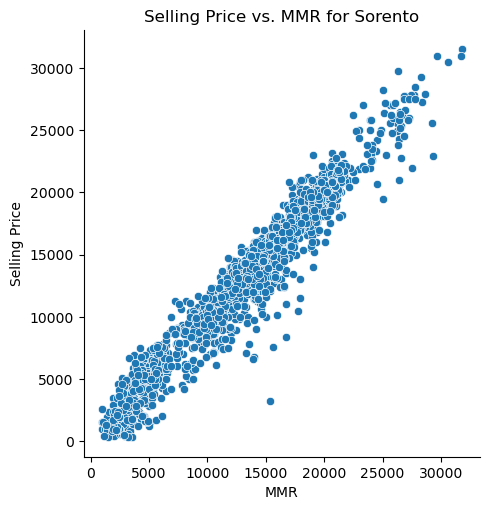

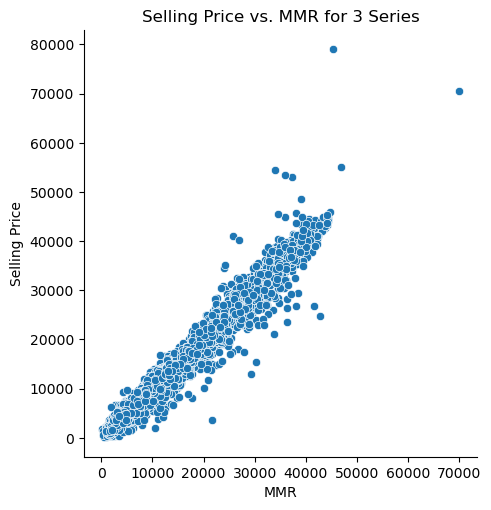

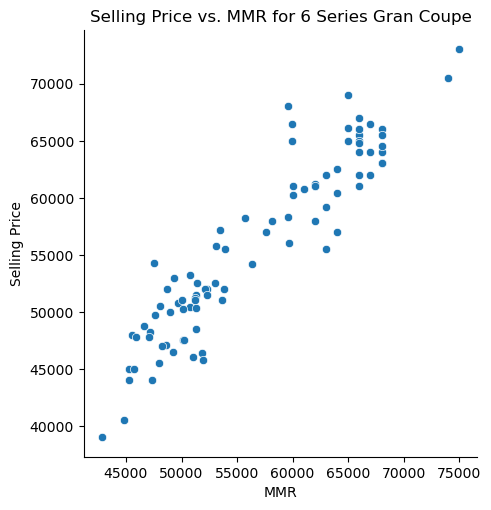

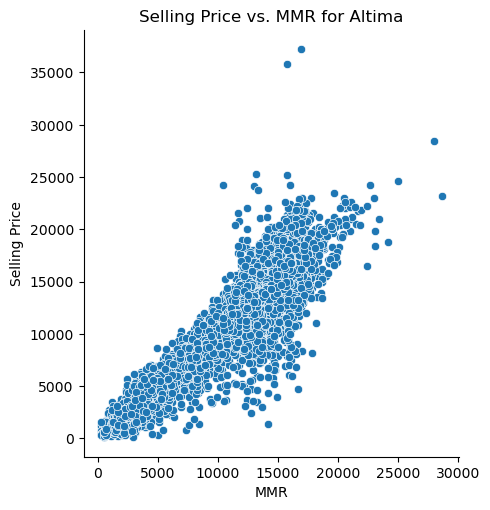

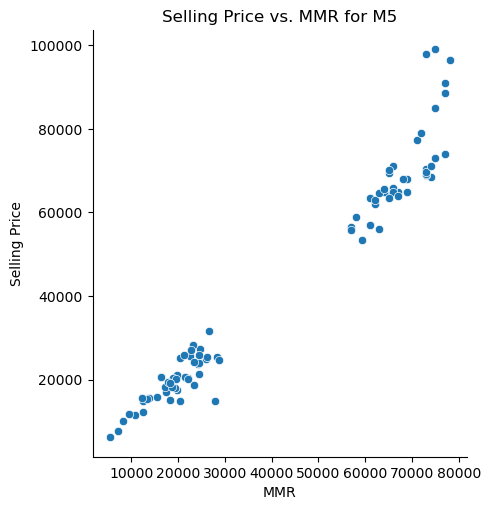

...

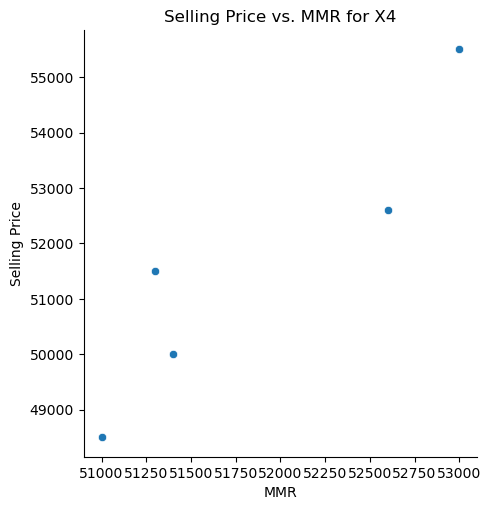

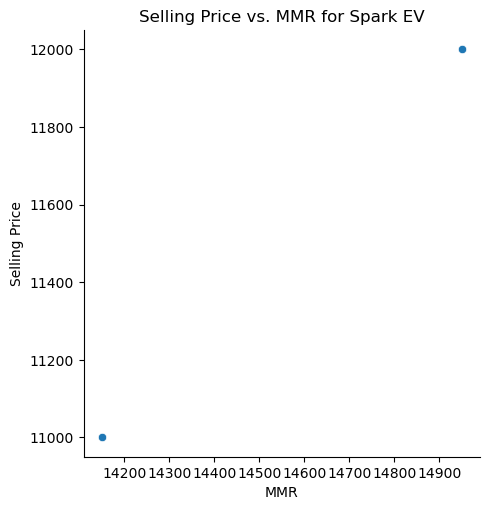

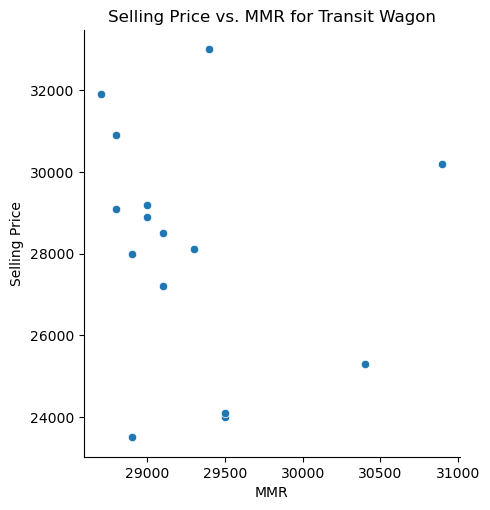

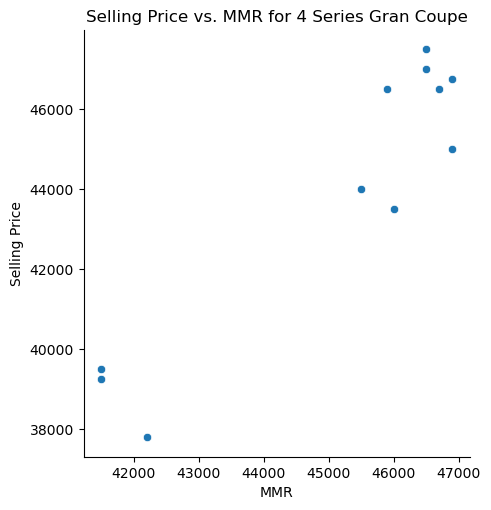

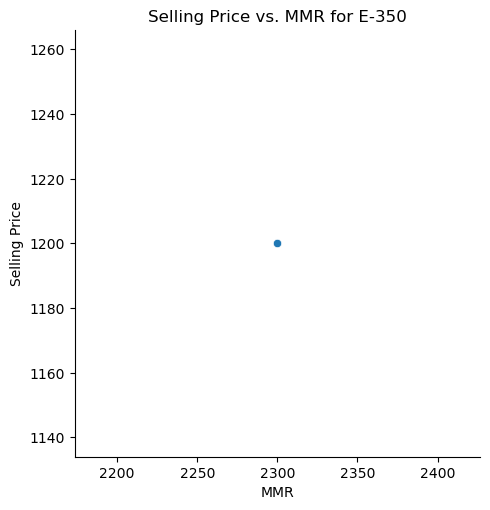

In [7]:
correlation_matrix = df_filtered[['sellingprice', 'mmr']].corr()


unique_models = df_filtered['model'].unique()

for model in unique_models:
    model_data = df_filtered[df_filtered['model'] == model]
    sns.relplot(x='mmr', y='sellingprice', data=model_data, kind='scatter')
    plt.title(f"Selling Price vs. MMR for {model}")
    plt.xlabel('MMR')
    plt.ylabel('Selling Price')
    plt.show()

In [8]:
print(df_filtered.shape)

(333610, 16)


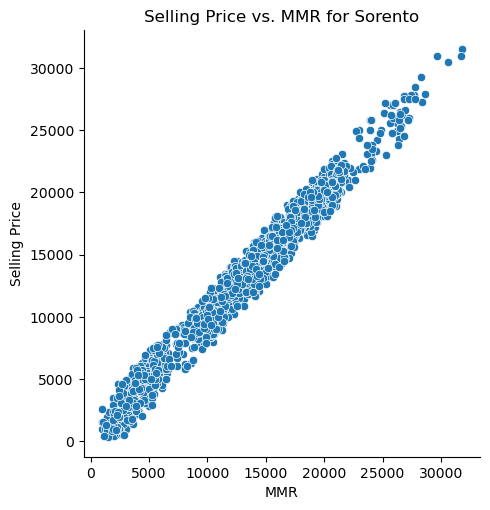

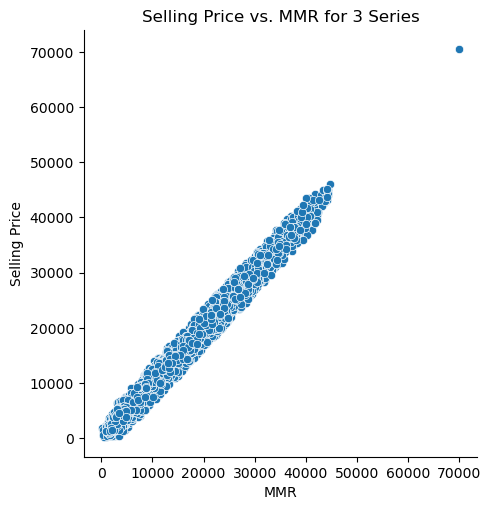

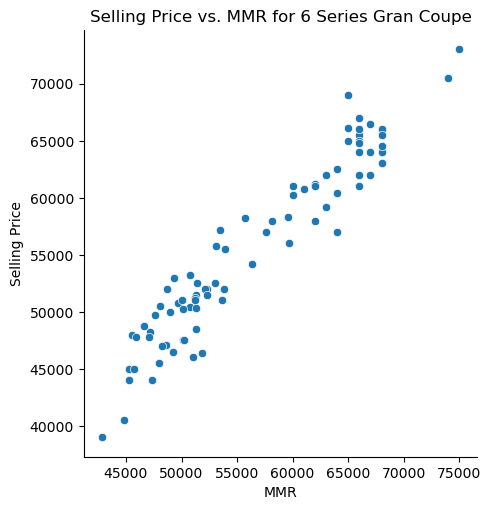

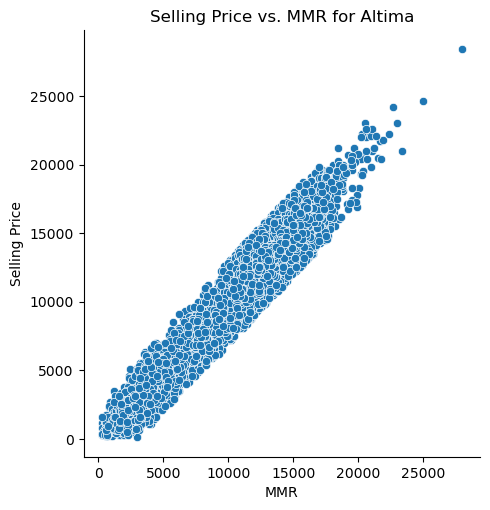

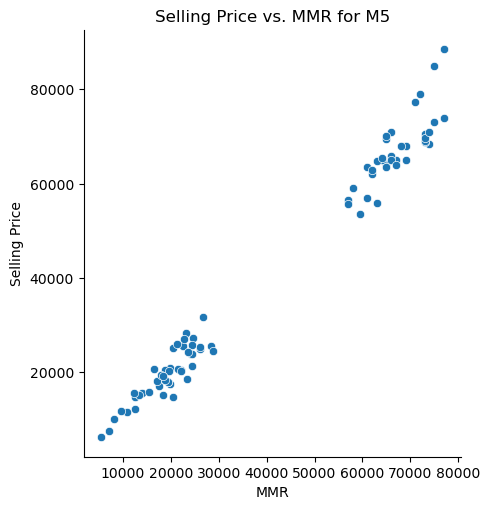

...

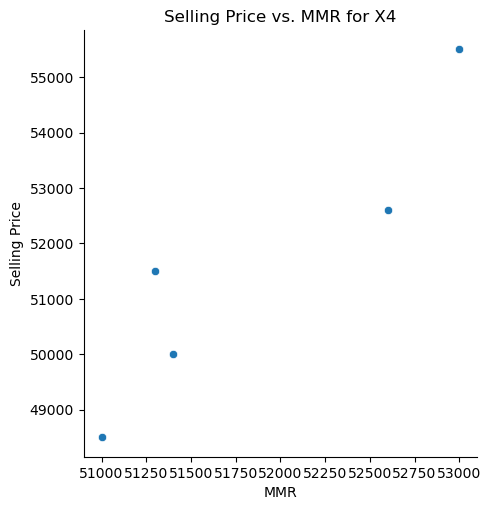

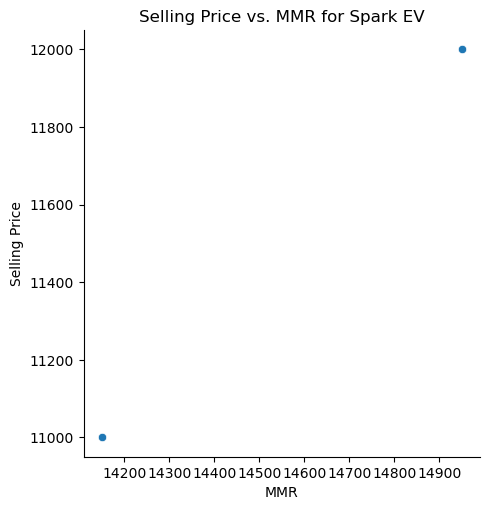

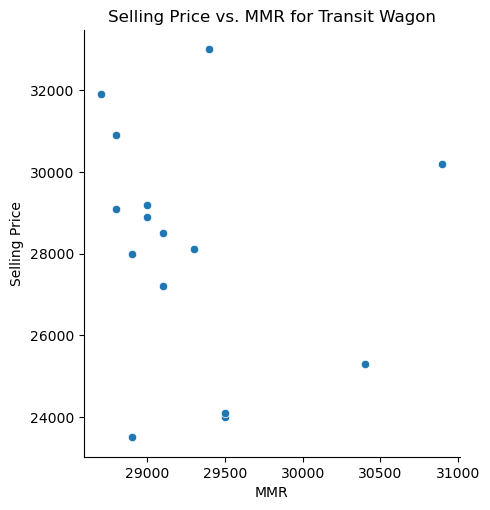

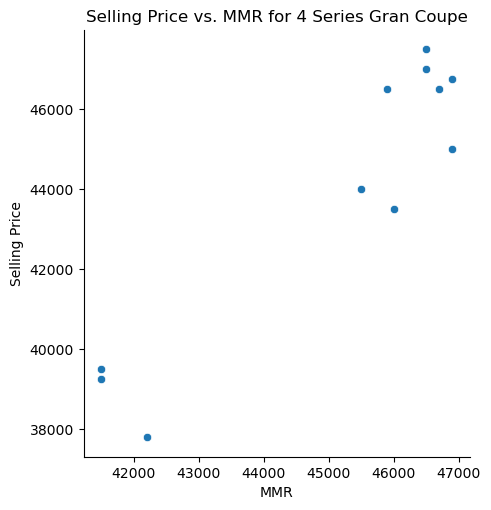

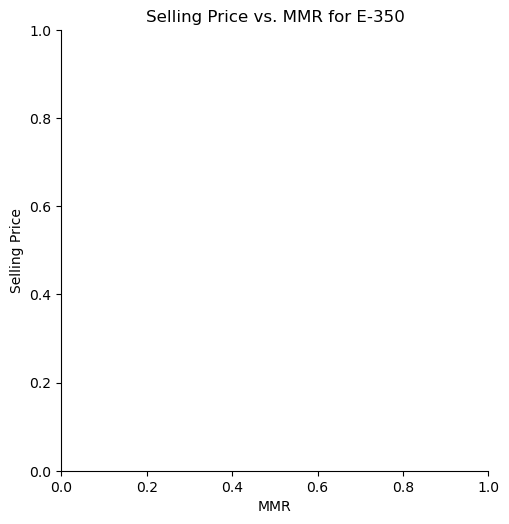

In [9]:
# Define a function to remove outliers based on residuals
def remove_outliers(model_data):
    # Fit a linear regression model
    lr = LinearRegression()
    X = model_data[['mmr']]
    y = model_data['sellingprice']  # Changed 'selling-price' to 'sellingprice'
    lr.fit(X, y)
    
    # Calculate residuals
    residuals = y - lr.predict(X)
    
    # Define a threshold (e.g., 2 standard deviations)
    threshold = 2 * residuals.std()  # Adjust this threshold as needed
    
    # Remove outliers
    model_data = model_data[abs(residuals) <= threshold]
    
    return model_data

# Create graphs for each unique value of "model"
unique_models = df_filtered['model'].unique()  # Changed 'df' to 'df_filtered'
updated_data = []

for model in unique_models:
    model_data = df_filtered[df_filtered['model'] == model]  # Changed 'df' to 'df_filtered'
    
    # Remove outliers based on residuals
    model_data = remove_outliers(model_data)
    updated_data.append(model_data)
    
    # Plot the graph
    sns.relplot(x='mmr', y='sellingprice', data=model_data, kind='scatter')  
    plt.title(f"Selling Price vs. MMR for {model}")
    plt.xlabel('MMR')
    plt.ylabel('Selling Price')
    plt.show()

# Concatenate updated dataframes outside the loop
df_filtered = pd.concat(updated_data, ignore_index=True)  


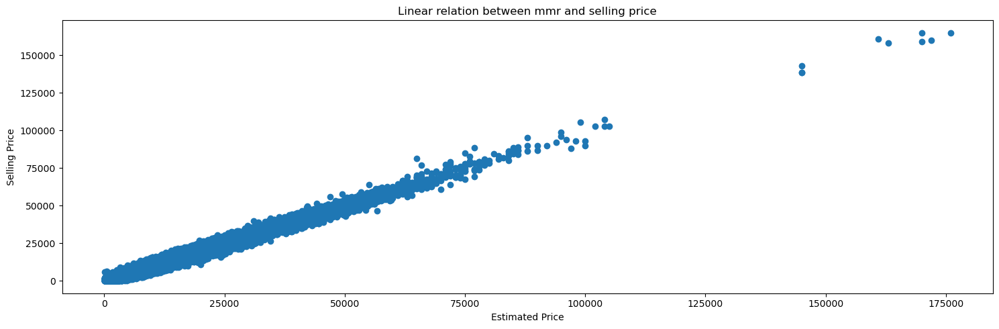

In [10]:
plt.figure(figsize=(15,5))
plt.scatter(df_filtered['mmr'],df_filtered['sellingprice'])
plt.xlabel("Estimated Price")
plt.ylabel('Selling Price')
plt.title("Linear relation between mmr and selling price")
plt.tight_layout()
plt.show()

In [11]:
print(df_filtered["make"].unique())

['Kia' 'BMW' 'Nissan' 'Chevrolet' 'Ford' 'Hyundai' 'Toyota' 'Dodge'
 'Chrysler' 'Honda']


In [12]:
print(df_filtered["make"].value_counts())

make
Ford         78458
Chevrolet    52085
Nissan       42108
Toyota       33955
Dodge        26120
Honda        23826
Hyundai      17834
BMW          16817
Kia          15118
Chrysler     14520
Name: count, dtype: int64


In [13]:
print(df_filtered.shape)

(320841, 16)


In [14]:
# Assuming 'make' and 'model' are columns in your DataFrame 'df_filtered'
unique_makes = df_filtered['make'].unique()

for make in unique_makes:
    models_for_make = df_filtered[df_filtered['make'] == make]['model'].unique()
    print(f"{make}: {models_for_make}")


Kia: ['Sorento' 'Optima' 'K900' 'Rio' 'Soul' 'Forte' 'Sportage' 'Sedona'
 'Spectra' 'Rondo' 'Borrego' 'Cadenza' 'Amanti' 'Sephia']
BMW: ['3 Series' '6 Series Gran Coupe' 'M5' '6 Series' '5 Series' 'X6' 'X1'
 '4 Series' 'X5' '7 Series' '1 Series' 'M3' 'X3' 'Z4' 'X5 M'
 '5 Series Gran Turismo' 'X6 M' 'Z3' 'M' 'M4' 'ActiveHybrid X6' 'M6'
 '2 Series' 'M6 Gran Coupe' '3 Series Gran Turismo' 'ActiveHybrid 7'
 'Z4 M' 'i8' 'ActiveHybrid 5' 'X4' '4 Series Gran Coupe']
Nissan: ['Altima' 'Versa' 'Versa Note' '370Z' 'Juke' 'NV' 'Leaf' 'NV200' 'Rogue'
 'Maxima' 'Xterra' 'Sentra' 'Frontier' 'Cube' 'Armada' 'Pathfinder'
 'Murano' 'GT-R' 'Altima Hybrid' '350Z' 'Titan' 'Quest' 'Rogue Select'
 'Truck' 'Murano CrossCabriolet' '200SX' 'NV Cargo' 'NV Passenger' '300ZX']
Chevrolet: ['Cruze' 'Camaro' 'Impala' 'Suburban' 'Malibu' 'Silverado 1500' 'Traverse'
 'Silverado 2500HD' 'Equinox' 'Captiva Sport' 'Volt' 'Express Cargo'
 'Colorado' 'Express' 'Sonic' 'HHR' 'Tahoe' 'Impala Limited' 'Aveo'
 'Corvette' 'mali

In [15]:
df_filtered = df_filtered.drop(columns=['body', 'trim', 'vin', 'seller', 'mmr', 'saledate', 'state'])

df_filtered.head()


,year,make,model,transmission,condition,odometer,color,interior,sellingprice
0,2015,Kia,Sorento,automatic,5.0,16639.0,white,black,21500.0
1,2015,Kia,Sorento,automatic,5.0,9393.0,white,beige,21500.0
2,2015,Kia,Sorento,automatic,5.0,14634.0,silver,black,21500.0
3,2015,Kia,Sorento,automatic,5.0,13757.0,red,black,20750.0
4,2015,Kia,Sorento,automatic,44.0,12862.0,gray,black,21000.0


In [16]:
print(df_filtered.shape)

(320841, 9)


In [17]:
df_filtered = df_filtered.apply(lambda x: x.str.upper() if x.dtype == "object" else x)  
df_filtered = df_filtered.dropna(how='any', axis=0)

In [18]:
print(df_filtered.shape)

(320841, 9)


In [19]:
print(df_filtered["make"].value_counts())

make
FORD         78458
CHEVROLET    52085
NISSAN       42108
TOYOTA       33955
DODGE        26120
HONDA        23826
HYUNDAI      17834
BMW          16817
KIA          15118
CHRYSLER     14520
Name: count, dtype: int64


In [20]:
df_filtered.head()

,year,make,model,transmission,condition,odometer,color,interior,sellingprice
0,2015,KIA,SORENTO,AUTOMATIC,5.0,16639.0,WHITE,BLACK,21500.0
1,2015,KIA,SORENTO,AUTOMATIC,5.0,9393.0,WHITE,BEIGE,21500.0
2,2015,KIA,SORENTO,AUTOMATIC,5.0,14634.0,SILVER,BLACK,21500.0
3,2015,KIA,SORENTO,AUTOMATIC,5.0,13757.0,RED,BLACK,20750.0
4,2015,KIA,SORENTO,AUTOMATIC,44.0,12862.0,GRAY,BLACK,21000.0


In [22]:
#encoder
le_make = LabelEncoder()
df_filtered["make"] = le_make.fit_transform(df_filtered["make"])
le_model = LabelEncoder()
df_filtered["model"] = le_model.fit_transform(df_filtered["model"])
le_color = LabelEncoder()
df_filtered["color"] = le_color.fit_transform(df_filtered["color"])
le_interior = LabelEncoder()
df_filtered["interior"] = le_interior.fit_transform(df_filtered["interior"])
le_transmission = LabelEncoder()
df_filtered["transmission"] = le_transmission.fit_transform(df_filtered["transmission"])


In [23]:
df_filtered.head()

,year,make,model,transmission,condition,odometer,color,interior,sellingprice
0,2015,7,224,0,5.0,16639.0,17,1,21500.0
1,2015,7,224,0,5.0,9393.0,17,0,21500.0
2,2015,7,224,0,5.0,14634.0,15,1,21500.0
3,2015,7,224,0,5.0,13757.0,14,1,20750.0
4,2015,7,224,0,44.0,12862.0,7,1,21000.0


In [24]:
X = df_filtered.drop("sellingprice", axis=1)
y = df_filtered["sellingprice"]

In [25]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

X_train, X_test, y_train, y_test = train_test_split(
    X, 
    y, test_size=0.3, 
    random_state=10
)
# Initialize and train the model
rf_reg = RandomForestRegressor(n_estimators=100, random_state=10)
rf_reg.fit(X_train, y_train)

print("Feature Importances:", rf_reg.feature_importances_)

print("train score: ", round(rf_reg.score(X_train, y_train) * 100, 2), "%")
print("test score: ", round(rf_reg.score(X_test, y_test) * 100, 2), "%")

# Make predictions
y_train_pred = rf_reg.predict(X_train)
y_test_pred = rf_reg.predict(X_test)

# Evaluate the model
train_rmse = mean_squared_error(y_train, y_train_pred, squared=False)
test_rmse = mean_squared_error(y_test, y_test_pred, squared=False)

print("Train RMSE:", train_rmse)
print("Test RMSE:", test_rmse)


Feature Importances: [0.11627701 0.14630847 0.27908077 0.00219446 0.035154   0.39616824
 0.01093885 0.0138782 ]
train score:  99.02 %
test score:  93.0 %
Train RMSE: 804.2299127094952
Test RMSE: 2165.555727639937


In [26]:
# from sklearn.tree import DecisionTreeRegressor
# from sklearn.metrics import mean_squared_error

# # Instantiate the Decision Tree model
# dt_regressor = DecisionTreeRegressor(random_state=10)

# # Train the model
# dt_regressor.fit(X_train, y_train)

# # Make predictions
# train_predictions = dt_regressor.predict(X_train)
# test_predictions = dt_regressor.predict(X_test)

# # Calculate RMSE
# train_rmse = mean_squared_error(y_train, train_predictions, squared=False)
# test_rmse = mean_squared_error(y_test, test_predictions, squared=False)

# #print("Shape of reg coefficients:", dt_regressor.coef_.shape)
# print("Feature Importances:", dt_regressor.feature_importances_)
# print("train score: ", round(dt_regressor.score(X_train, y_train) * 100, 2), "%")
# print("test score: ", round(dt_regressor.score(X_test, y_test) * 100, 2), "%")


# print("Train RMSE:", train_rmse)
# print("Test RMSE:", test_rmse)


In [31]:
import joblib

data = {"rf_reg": rf_reg, "make": le_make, "model": le_model, "color": le_color, "interior": le_interior, "transmission": le_transmission}
joblib.dump(data, 'saved_model.pkl')


['saved_model.pkl']

In [32]:
import sklearn
print(sklearn.__version__)


1.2.2


In [27]:
# import pickle
# data = {"rf_reg": rf_reg, "make": le_make, "model": le_model, "color": le_color, "interior": le_interior, "transmission": le_transmission}
# with open('saved_model.pkl', 'wb') as file:
#     pickle.dump(data, file)   